# **Saving processed images for dataset creation**

# Connect to Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# Import

In [ ]:
%%capture
!pip install ultralytics

from google.colab.patches import cv2_imshow
from IPython.display import  display, Image
from ultralytics import YOLO, YOLOE
import numpy as np
import ultralytics
import glob
import cv2

ultralytics.checks()

# Use the model

In [ ]:
model_choice = 'model_3'
model_path = f'/content/drive/MyDrive/sharingColab/invoice/{model_choice}/use/best_seg.pt'
image_path = '/content/drive/MyDrive/sharingColab/invoice/raw_image/new/*'

In [ ]:
model_path = f'/content/drive/MyDrive/sharingColab/invoice/{model_choice}/latest/best_seg.pt'

In [ ]:
sr = 0.3 # scale_ratio
image_path_list = sorted(glob.glob(image_path)) # Load image paths into image_path_list

image_list = [cv2.resize(cv2.imread(p), (0, 0), fx=sr, fy=sr) for p in image_path_list]

In [ ]:
print(f"Using model path: {model_path}")
model = YOLO(model_path)
result_list = model(image_path, imgsz=1024)

Using model path: /content/drive/MyDrive/sharingColab/invoice/model_3/latest/best_seg.pt


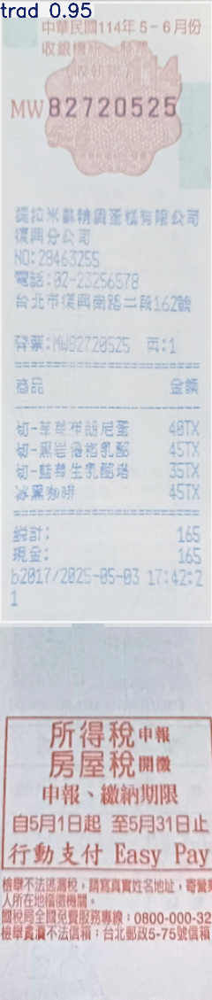

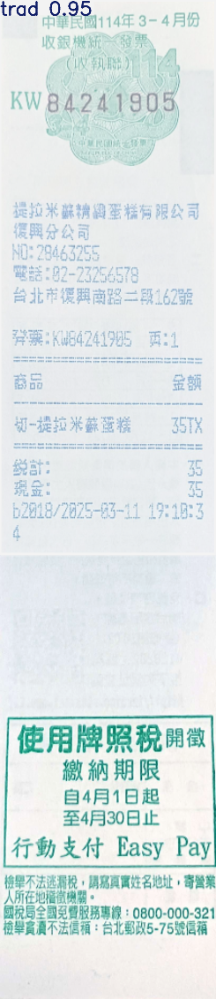

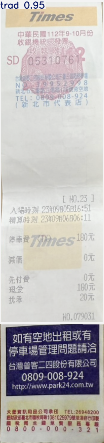

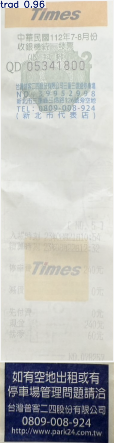

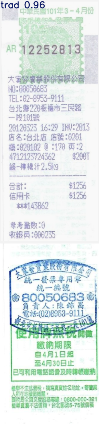

...

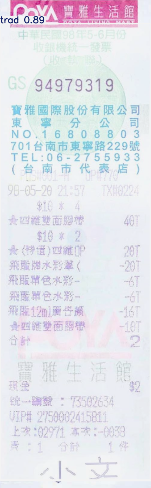

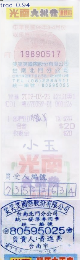

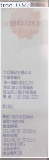

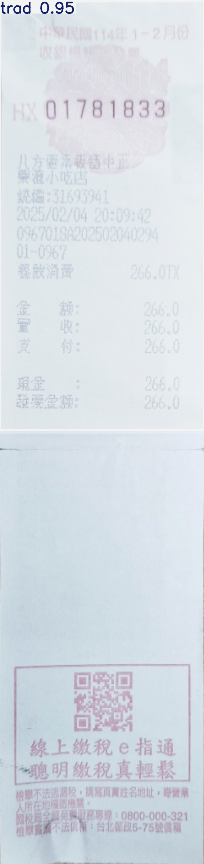

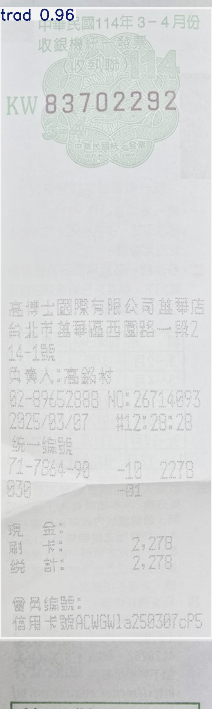

In [ ]:
for res in result_list:
  cv2_imshow(cv2.resize(res.plot(), (0, 0), fx=sr, fy=sr))

In [ ]:
label_list = []
for i, result in enumerate(result_list):
  if len(result.boxes.cls) == 0:
    result_list.pop(i)
    continue
  label_index = result.boxes.cls.cpu().numpy().astype(np.uint8).item() # Retrieve the label index from the result
  label_list.append(model.names[label_index]) # Append the label name to the label_list

In [ ]:
len(result_list)

18

0. trad


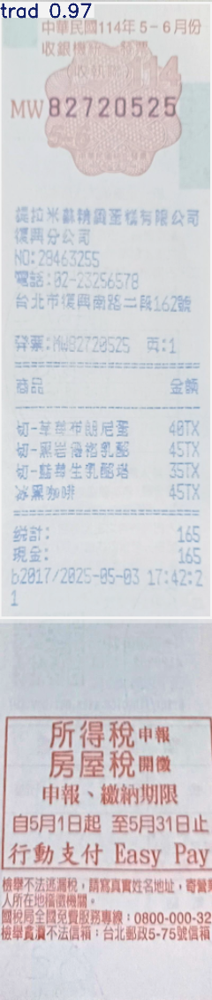


1. trad


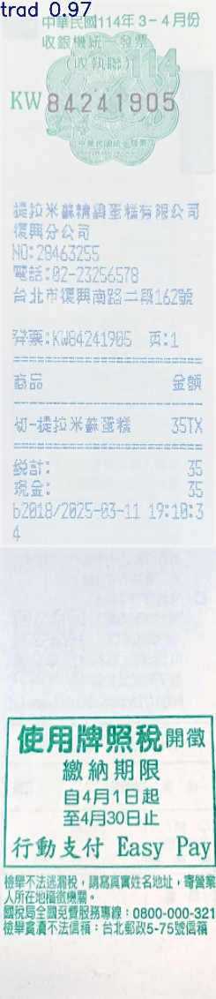


2. trad


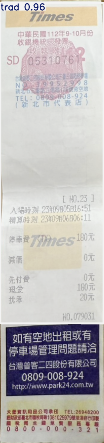


3. trad


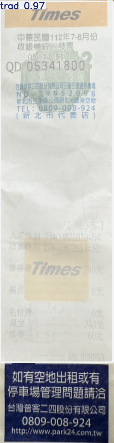


4. trad


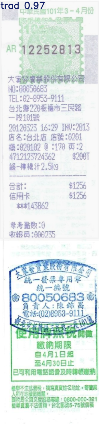


5. trad


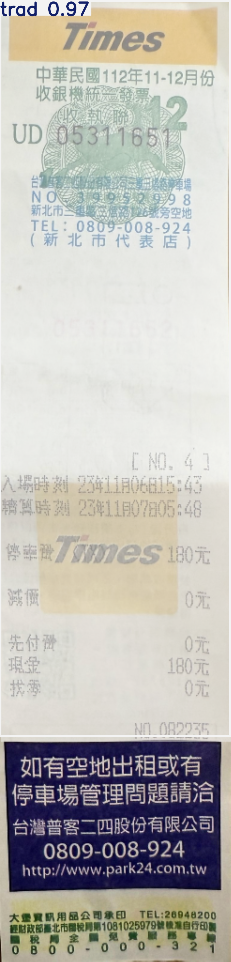


6. trad


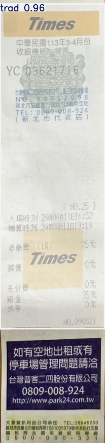


7. trad


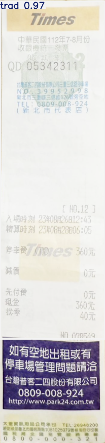


8. trad


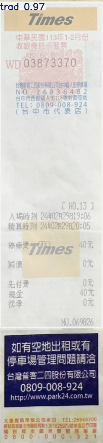


9. trad


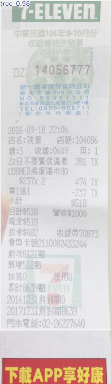


10. trad


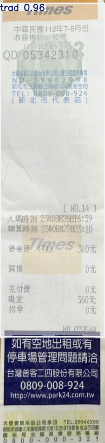


11. trad


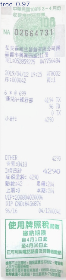


12. trad


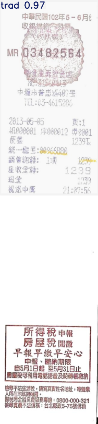


13. trad


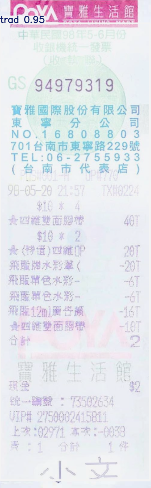


14. trad


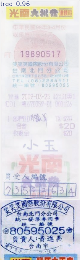


15. trad


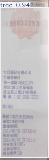


16. trad


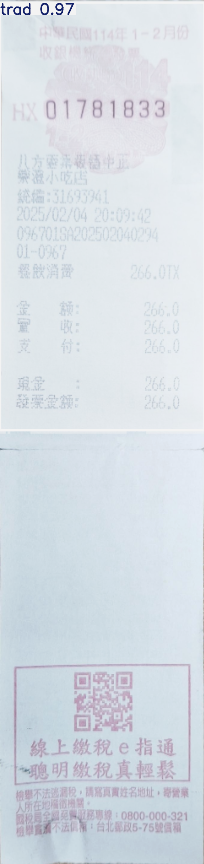


17. trad


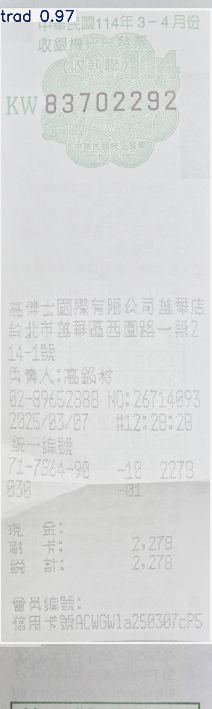

In [ ]:
# @title Review the results
for i, result in enumerate(result_list):
  label = label_list[i]
  print(f"{i}. {label}")

  result = result.plot() # Convert the result to a NumPy ndarray (YOLO plot, not matplotlib)
  result = cv2.resize(result, (0, 0), fx=sr, fy=sr) # resize result
  cv2_imshow(result) # show the result
  print()

# Process mask

In [ ]:
# @title Remove the directory named "mask"
!rm -r mask

rm: cannot remove 'mask': No such file or directory


In [ ]:
!mkdir mask

mask_list = [result.masks.data for result in result_list] # Save the masks to mask_list
processed_mask_list = []

for i, masks in enumerate(mask_list):
  for j, mask_tensor in enumerate(masks):
    # Move mask_tensor to cpu, convert it to a NumPy ndarray of type uint8, and brighten non-mask areas
    mask = mask_tensor.cpu().numpy().astype(np.uint8) * 255

    image = image_list[i]
    image_shape = image.shape # Get image shape as (height, width)

    #★ cv2.resize(src, (width, height))
    mask = cv2.resize(mask, (image_shape[1], image_shape[0])) # Resize the mask to match the image

    result = cv2.bitwise_and(image, image, mask=mask) # Fill the masked areas with black

    b, g, r = cv2.split(result) # Split the color channels (B, G, R) of the result
    rgba = cv2.merge([b, g, r, mask]) # Merge the color channels (B, G, R, A)
    label_name = label_list[i]
    processed_mask_list.append([rgba, mask, label_name]) # Append [rgba, mask, label_name] to the processed_mask_list

    i = f"{i:03d}" # Configure the format of 'i' as '000'
    cv2.imwrite(f'mask/mask_{i}_{j}.png', rgba) # Store rbga to the folder called 'mask'

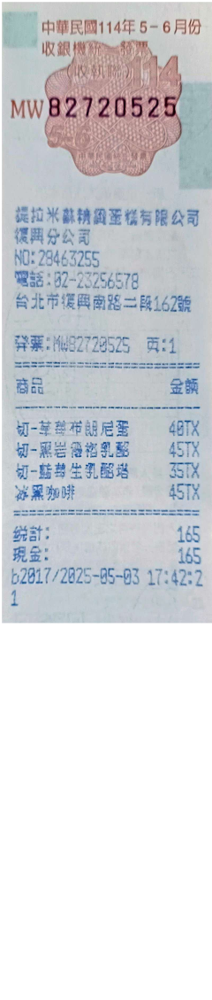

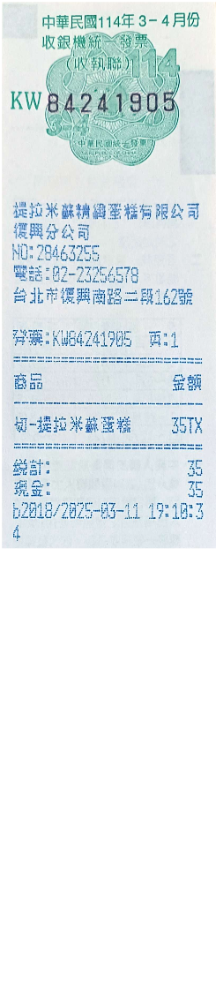

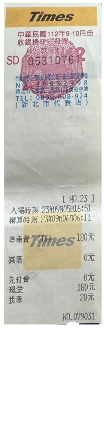

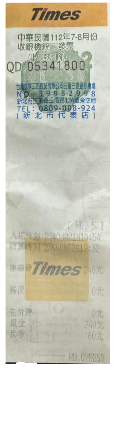

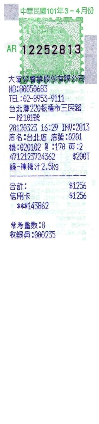

...

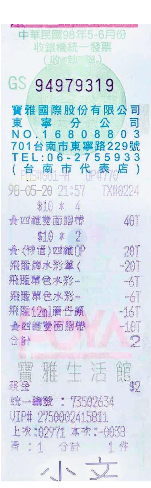

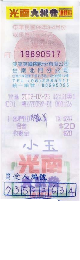

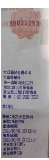

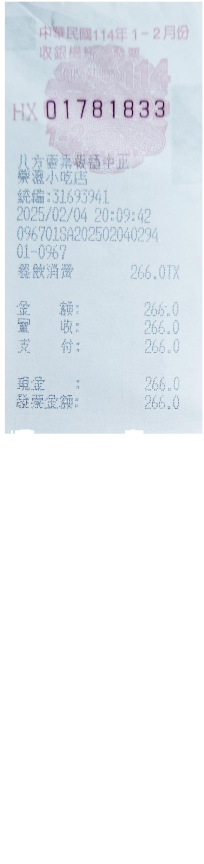

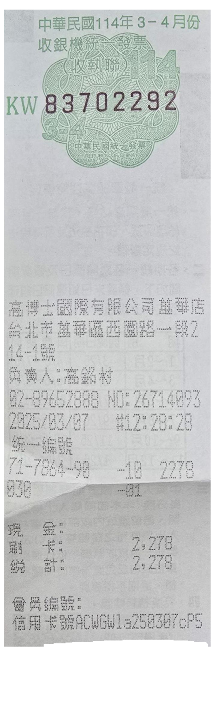

In [ ]:
# @title Review the processed images from processed_mask_list

for image, mask, label_name in processed_mask_list:
  cv2_imshow(image)

# Rotate the images

In [ ]:
# @title Remove the folder called "rotate"
!rm -r rotate

rm: cannot remove 'rotate': No such file or directory


label name:  trad
center point： (120.49998474121094, 352.49993896484375)
width & height： (236.99996948242188, 700.9998779296875)
rotation angle： -0.0


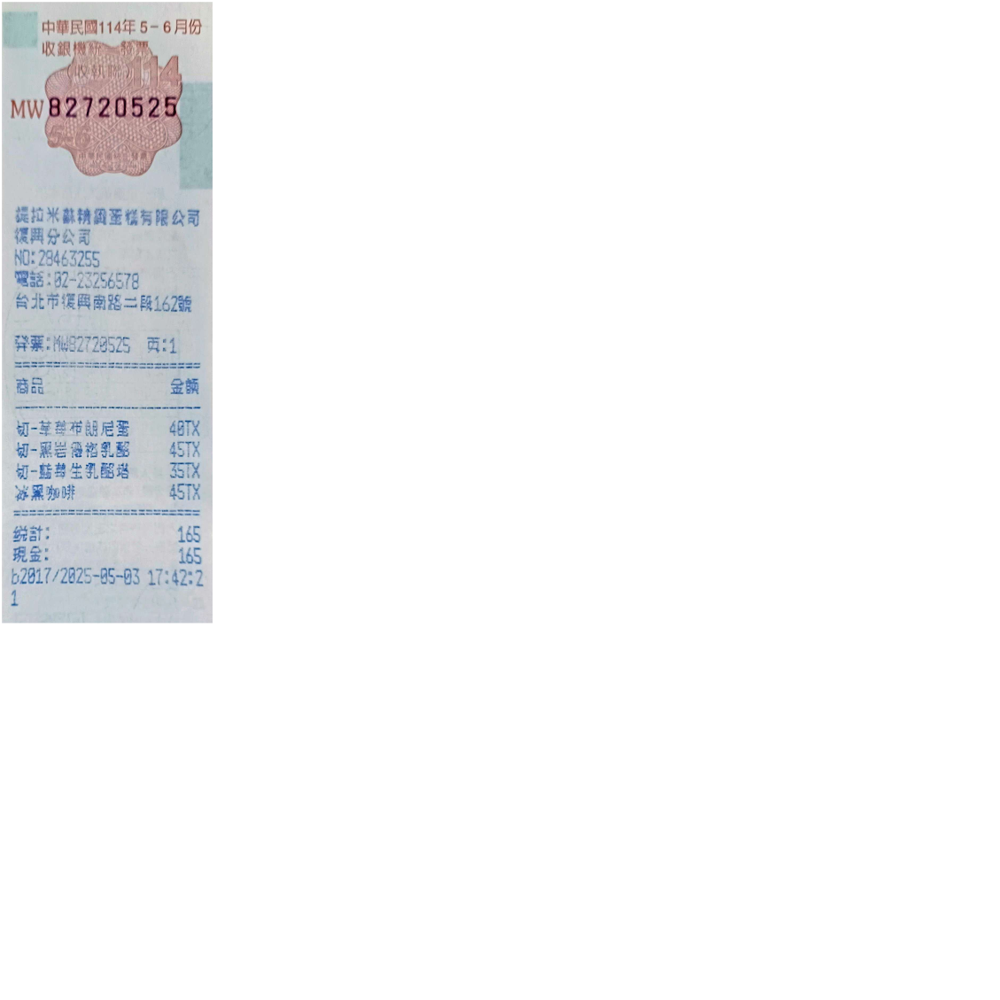

label name:  trad
center point： (122.99998474121094, 311.49993896484375)
width & height： (241.99996948242188, 618.9998779296875)
rotation angle： -0.0


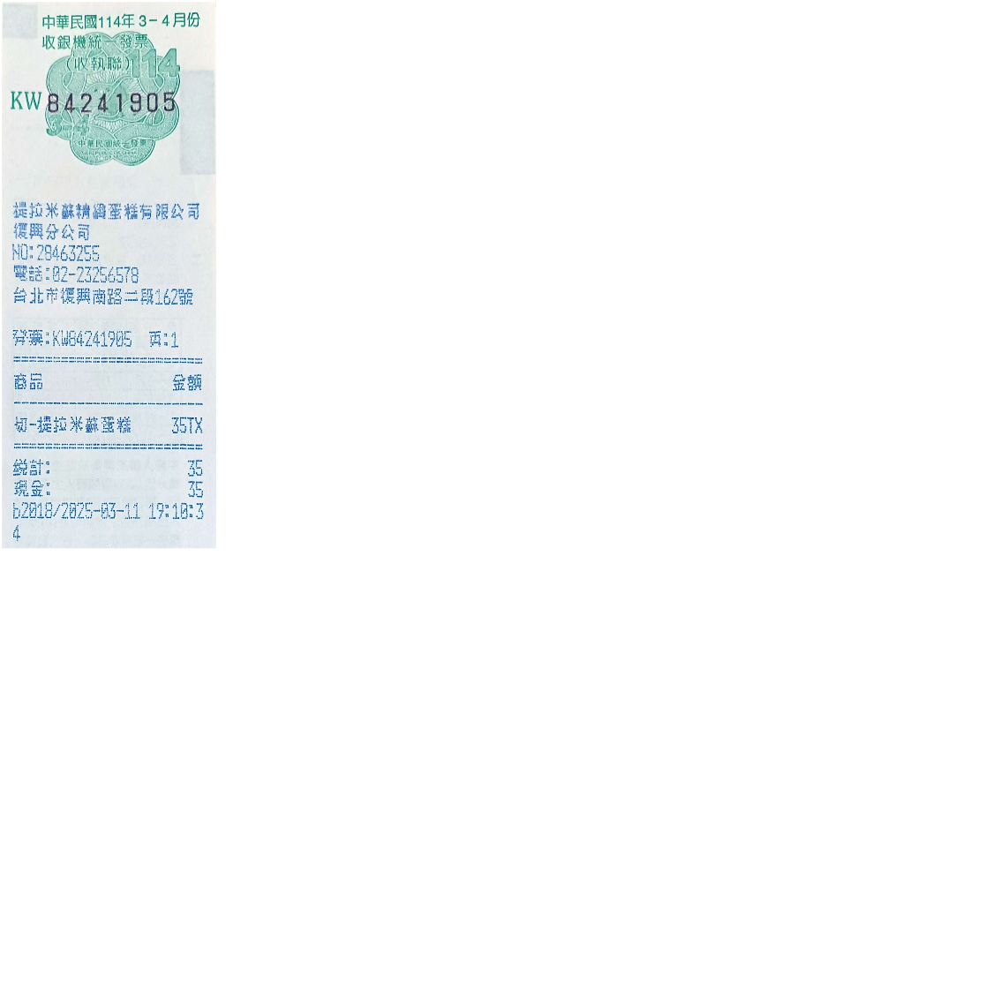

label name:  trad
center point： (52.49999237060547, 162.99996948242188)
width & height： (96.99998474121094, 321.99993896484375)
rotation angle： -0.0


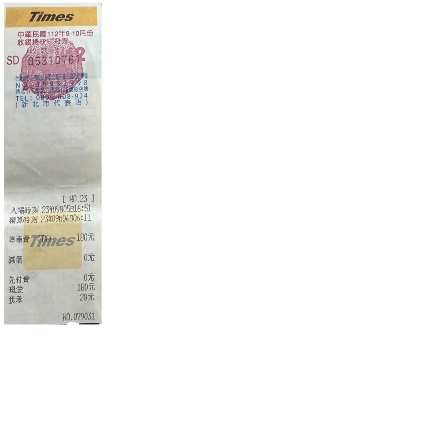

label name:  trad
center point： (57.0, 182.5)
width & height： (361.0, 104.0)
rotation angle： 90.0


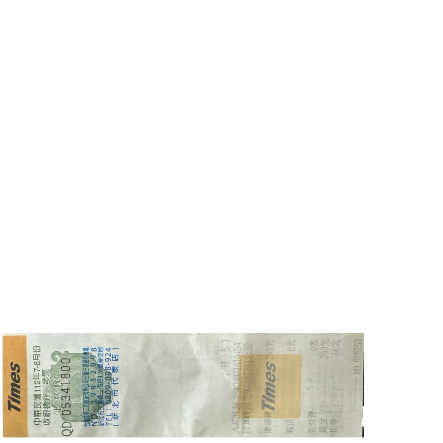

label name:  trad
center point： (50.0, 120.5)
width & height： (239.0, 92.0)
rotation angle： 90.0


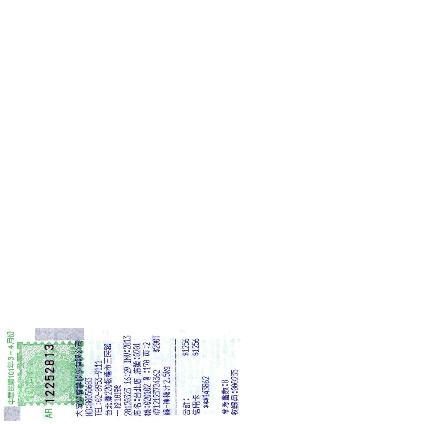

label name:  trad
center point： (117.00001525878906, 371.49993896484375)
width & height： (740.9998779296875, 223.99996948242188)
rotation angle： 90.0


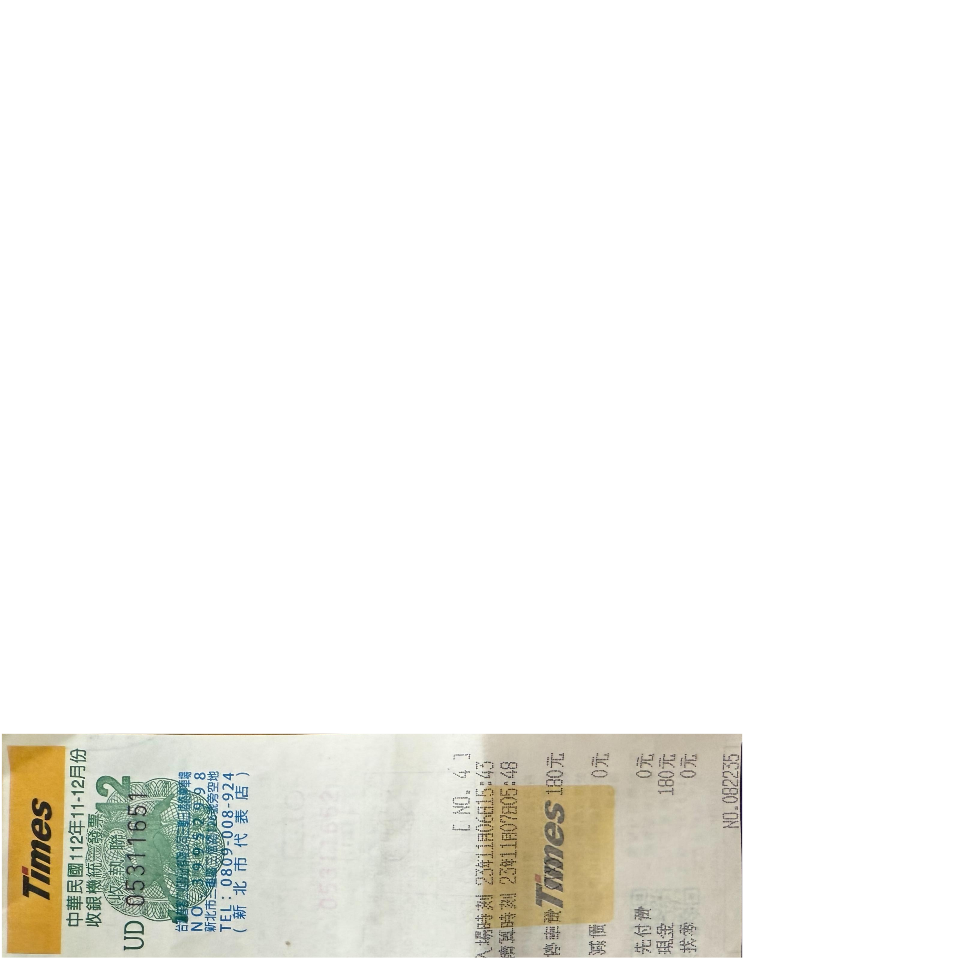

label name:  trad
center point： (52.5, 166.5)
width & height： (325.0, 101.0)
rotation angle： 90.0


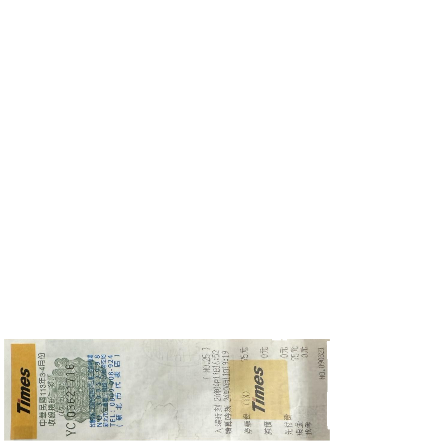

label name:  trad
center point： (52.5, 170.0)
width & height： (338.0, 101.0)
rotation angle： 90.0


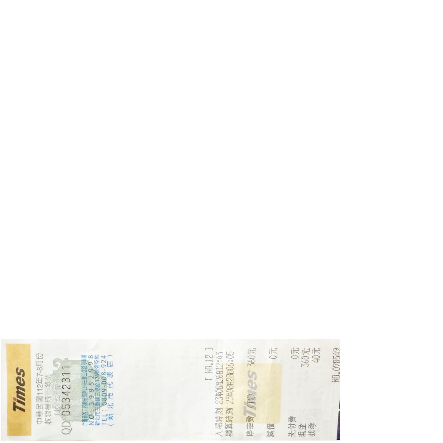

label name:  trad
center point： (52.0, 165.5)
width & height： (327.0, 96.0)
rotation angle： 90.0


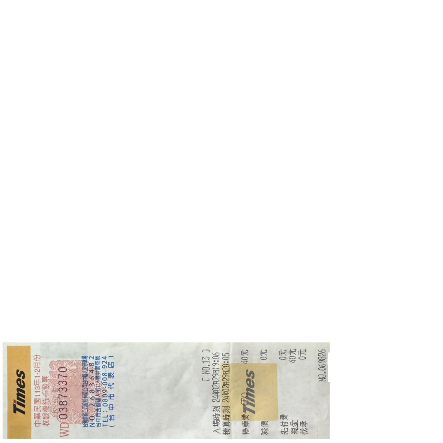

label name:  trad
center point： (55.0, 165.5)
width & height： (329.0, 104.0)
rotation angle： 90.0


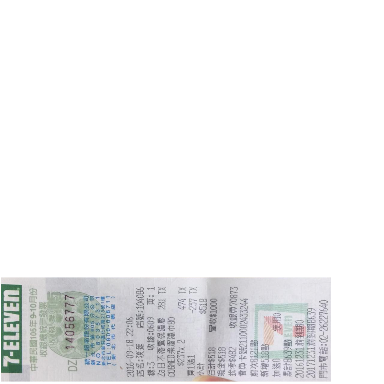

label name:  trad
center point： (52.5, 170.0)
width & height： (336.0, 101.0)
rotation angle： 90.0


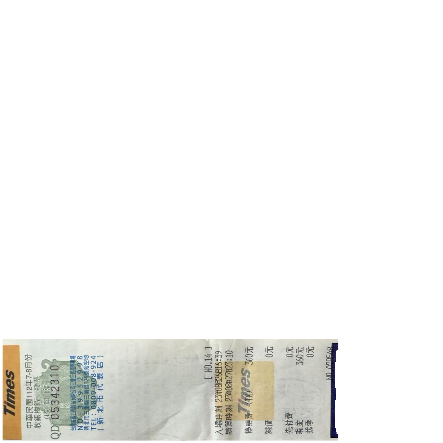

label name:  trad
center point： (32.999996185302734, 110.99998474121094)
width & height： (61.99999237060547, 217.99996948242188)
rotation angle： 0.0


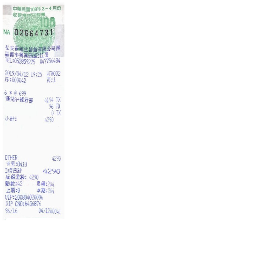

label name:  trad
center point： (49.5, 97.99998474121094)
width & height： (193.99996948242188, 90.99998474121094)
rotation angle： 90.0


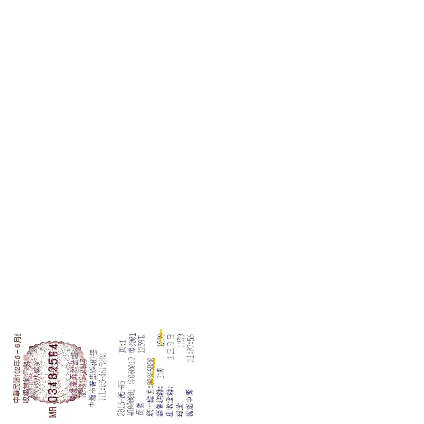

label name:  trad
center point： (75.5, 252.5)
width & height： (457.0, 149.0)
rotation angle： 90.0


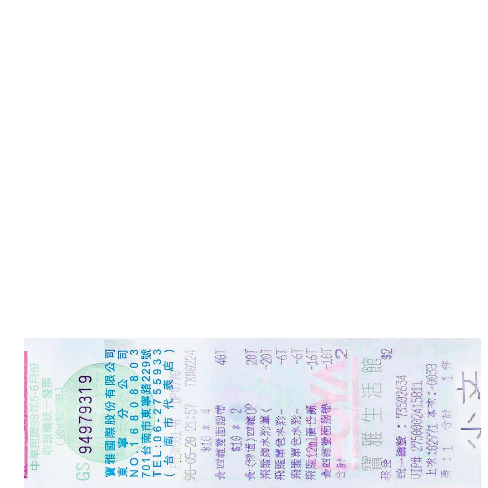

label name:  trad
center point： (39.5, 100.0)
width & height： (200.0, 79.0)
rotation angle： 90.0


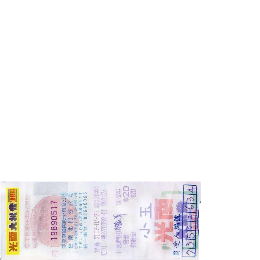

label name:  trad
center point： (24.499996185302734, 82.49998474121094)
width & height： (46.99999237060547, 148.99996948242188)
rotation angle： -0.0


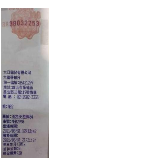

label name:  trad
center point： (103.0, 217.0)
width & height： (432.0, 198.0)
rotation angle： 90.0


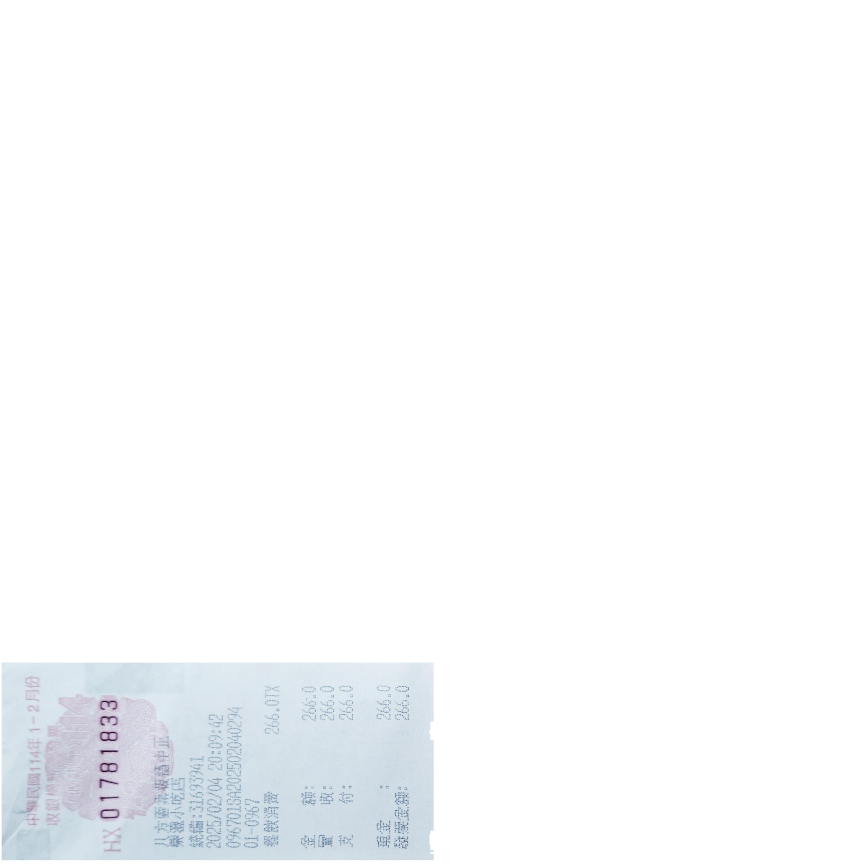

label name:  trad
center point： (107.0, 327.5)
width & height： (637.0, 206.0)
rotation angle： 90.0


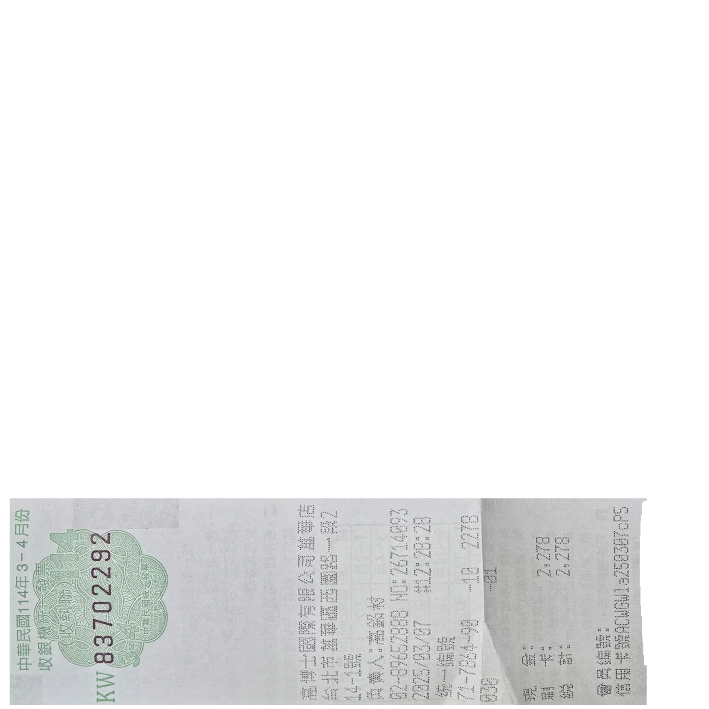

In [ ]:
!mkdir rotate

rotated_list = []
for i, [image, mask, label_name] in enumerate(processed_mask_list):
  #★ cv2.RETR_EXTERNAL: Retrieve only the external contours
  #★ cv2.CHAIN_APPROX_SIMPLE: Save only the essential contour points
  # find contours
  contours, hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  if len(contours) == 0:
    raise ValueError('No contours found') # If contours are not found, raise an exception

  (x, y), (w, h), angle = cv2.minAreaRect(contours[0])
  print("label name: ", label_name)
  print("center point：", (x, y))
  print("width & height：", (w, h))
  print("rotation angle：", angle)

  i = f"{i:03d}" # Configure the format of 'i' as '000'

  for j in range(4):
    angle += 90

    (h_img, w_img) = mask.shape

    side_length = h_img if h_img > w_img else w_img # Get the maximum length
    rect = (side_length, side_length) # Store the rectangle shape data

    # Store the center point
    center = side_length // 2
    center = (center, center)

    M = cv2.getRotationMatrix2D(center, angle, 1.0) # Create a rotation matrix array

    rotated_img = cv2.warpAffine(image, M, rect, flags=cv2.INTER_LINEAR, borderValue=(0,0,0)) # rotate image
    rotated_mask = cv2.warpAffine(mask, M, rect, flags=cv2.INTER_NEAREST) #rotate mask
    rotated_list.append([rotated_img, rotated_mask, label_name]) # Append [rotated_img, rotated_mask, label_name] to the processed_mask_list


    cv2.imwrite(f'rotate/rotate_{i}_{j}.png', rotated_img) # Store rotated_img to the directory named 'rotate'
  cv2_imshow(rotated_img)

# Crop the image

In [ ]:
# @title Remove the folders called "final_result", "elec", "trad", and "bill" if they exist
!rm -r final_result elec trad bill

rm: cannot remove 'final_result': No such file or directory
rm: cannot remove 'elec': No such file or directory
rm: cannot remove 'trad': No such file or directory
rm: cannot remove 'bill': No such file or directory


In [ ]:
# 1. Create the directory named "final_result"
# 2. Go to the final_result folder
# 3. Create the folders called "elec", "trad", and "bill"
!mkdir final_result
%cd final_result
!mkdir elec trad bill

elec_index, trad_index, bill_index = 0, 0, 0
elec_list, trad_list, bill_list = [], [], []

for i, [image, mask, label_name] in enumerate(rotated_list):
  ys, xs = np.where(mask == 255) # Get the coordinates (ys, xs) where the mask is white (255)
  if len(ys) > 0 and len(xs) > 0:
    x_min, x_max = xs.min(), xs.max() # Retrieve the minimum and maximum 'x' values
    y_min, y_max = ys.min(), ys.max() # Get the min and max 'y' coordinates

  cropped_img = image[y_min:y_max+1, x_min: x_max+1] # Crop the image using bounding box coordinates

  # Choose the destination folder and the number to use in the filename,
  # then append the cropped_img to the matching list
  if label_name == 'elec':
    folder = 'elec'
    elec_index += 1
    i = elec_index
    elec_list.append(cropped_img)

  elif label_name == 'trad':
    folder = 'trad'
    trad_index += 1
    i = trad_index
    trad_list.append(cropped_img)

  else:
    folder = 'bill'
    bill_index += 1
    i = bill_index
    bill_list.append(cropped_img)

  i = f"{i:03d}" # Configure the format of 'i' as '000'
  cv2.imwrite(f'{folder}/result_{folder}_{i}.png', cropped_img) # Save the final result to the matching directory

# go back to the content
%cd /content

/content/final_result
/content


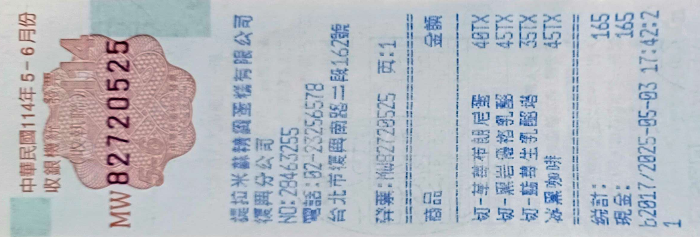

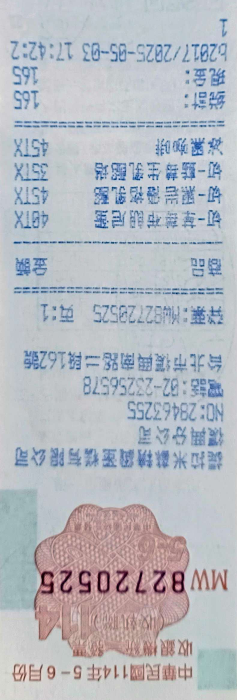

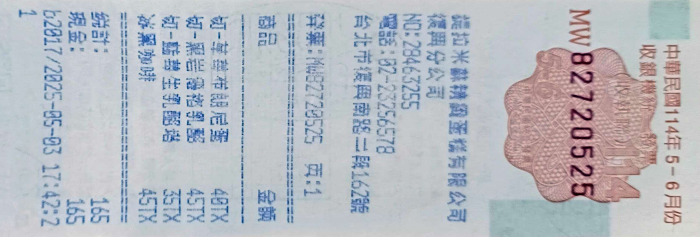

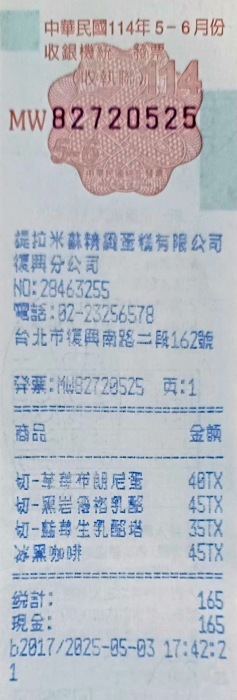

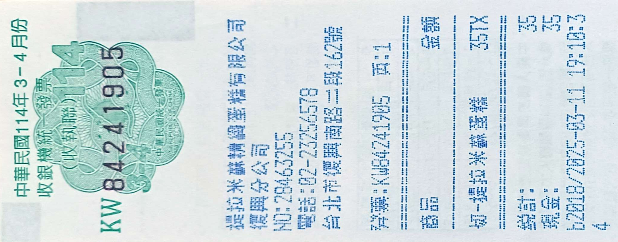

...

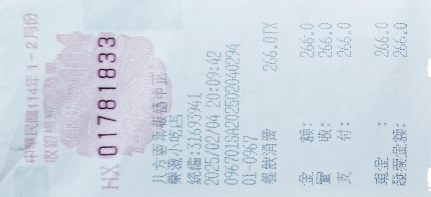

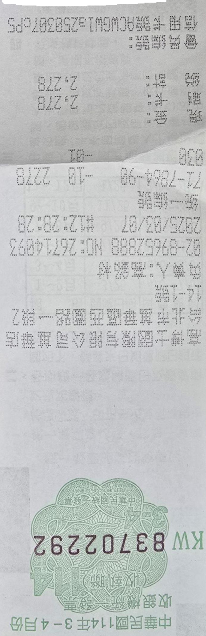

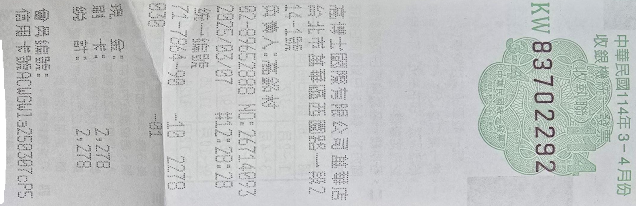

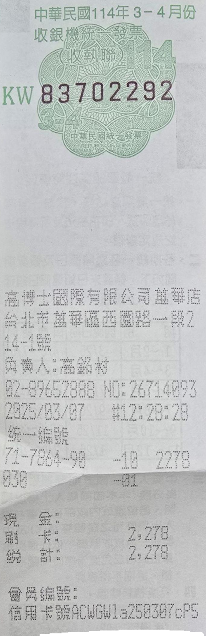

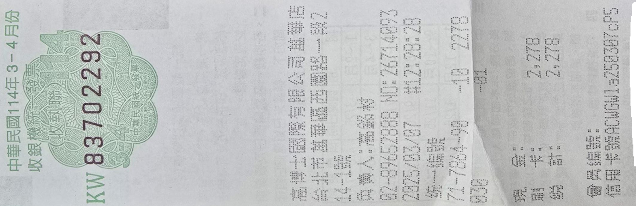

In [ ]:
# @title Review the final result
def display_list(list):
  for img in list:
    cv2_imshow(img)

for list in [elec_list, trad_list, bill_list]:
  display_list(list)

# Store the final result

In [ ]:
def copy_to_my_drive():
 !cp final_result/elec/* /content/drive/MyDrive/sharingColab/invoice/image_angle/elec
 !cp final_result/trad/* /content/drive/MyDrive/sharingColab/invoice/image_angle/trad
 !cp final_result/bill/* /content/drive/MyDrive/sharingColab/invoice/image_angle/bill

In [ ]:
copy_to_my_drive()

cp: cannot stat 'final_result/elec/*': No such file or directory
cp: cannot stat 'final_result/bill/*': No such file or directory
